In [1]:
import matplotlib.pyplot as plt
import numpy as np
# mongoclient#
import pymongo
from pymongo import MongoClient
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import json
import plotly.express as px
import plotly.graph_objects as go
from scipy import signal

In [2]:
mGClient = MongoClient(f'mongodb://10.250.4.35:27017') 

In [3]:
db = mGClient['experiments']   
collection = db['Exp_2024-04-15T11_53_42_181Z_BtsData']
#salva su txt data
# with open('data.txt', 'w') as outfile:
#     json.dump(data, outfile)


In [4]:
queri = collection.find()
print(queri)

In [5]:
final6 = []
final7 = []

for x in queri:
    try:
        fii = x["samples"]["6"]["value"]
        fiii = x["samples"]["7"]["value"]
        # final.append((fii, fiii))
        final6.append(fii)
        final7.append(fiii)
    except:

        print(x)

{'_id': ObjectId('661cf9284d815848c0fe4c63'), 'index': 0, 'samples': {'0': {'value': 0.0, 'status': 1}, '1': {'value': 0.0, 'status': 1}}, 'timeStamp': '2024-04-15T11:53:43.291Z'}
{'_id': ObjectId('661cf9284d815848c0fe4c64'), 'index': 1, 'samples': {'0': {'value': 0.0, 'status': 1}, '1': {'value': 0.0, 'status': 1}}, 'timeStamp': '2024-04-15T11:53:43.292Z'}
{'_id': ObjectId('661cf9284d815848c0fe4c65'), 'index': 2, 'samples': {'0': {'value': 0.0, 'status': 1}, '1': {'value': 0.0, 'status': 1}}, 'timeStamp': '2024-04-15T11:53:43.293Z'}
{'_id': ObjectId('661cf9284d815848c0fe4c66'), 'index': 3, 'samples': {'0': {'value': 0.0, 'status': 1}, '1': {'value': 0.0, 'status': 1}}, 'timeStamp': '2024-04-15T11:53:43.294Z'}
{'_id': ObjectId('661cf9284d815848c0fe4c67'), 'index': 4, 'samples': {'0': {'value': 0.0, 'status': 1}, '1': {'value': 0.0, 'status': 1}}, 'timeStamp': '2024-04-15T11:53:43.295Z'}
{'_id': ObjectId('661cf9284d815848c0fe4c68'), 'index': 5, 'samples': {'0': {'value': 0.0, 'status': 

In [6]:
data2 = [(x["samples"]["6"]["status"], x["samples"]["7"]["status"]) for x in queri]

In [7]:
# for x in queri:
#     print(x)

data = [(x["samples"]["7"]["value"], x["samples"]["8"]["value"]) for x in queri]

In [8]:
data2[43366:43401]

[]

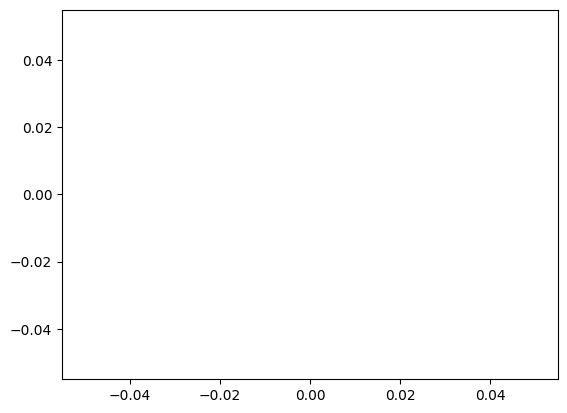

In [9]:
plt.plot(np.array(final7))

In [10]:
# remove data if data = 2
final7 = [x for x in final6 if x != 2]

In [11]:
arrayvero = np.delete(np.array(final6), np.where(np.array(final6) ==2))

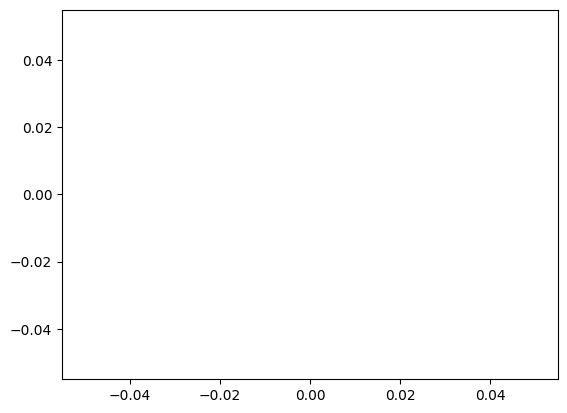

In [12]:
plt.plot(arrayvero)

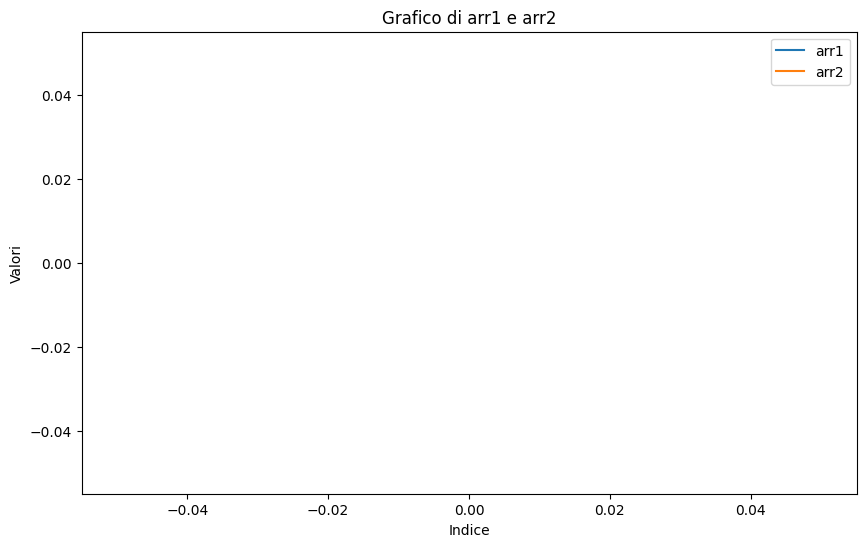

In [13]:

plt.figure(figsize=(10,6))

plt.plot(arrayvero, label='arr1')
plt.plot(final7, label='arr2')

plt.title('Grafico di arr1 e arr2')
plt.xlabel('Indice')
plt.ylabel('Valori')

plt.legend()
plt.show()


In [14]:
Sampling_frequency = 1000
band_lo = 20
band_hi = 450
Niquist_frequency = Sampling_frequency/2
nor_band_lo = band_lo/Niquist_frequency
nor_band_hi = band_hi/Niquist_frequency
sos_band = signal.iirfilter(4, [ nor_band_lo, nor_band_hi],btype='band', ftype='butter', output = "sos")

del_freq = 50
nor_del_freq = del_freq/Niquist_frequency
Quality = 30
b, a = signal.iirnotch(nor_del_freq, Quality, Sampling_frequency)


In [15]:
filtered_band = signal.sosfiltfilt(sos_band , final7)
filtered = signal.lfilter(b, a, filtered_band)

ValueError: The length of the input vector x must be greater than padlen, which is 27.

In [ ]:
len(filtered)/60

2499.45

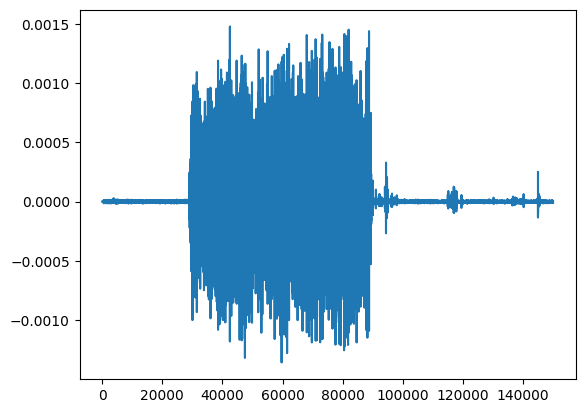

In [ ]:
plt.plot(filtered)

# envelope

In [ ]:
# Apply Fourier Transform
def features(seg_i):
  frequency_domain = np.fft.fft(seg_i)
  # Compute magnitude spectrum
  magnitude_spectrum = np.abs(frequency_domain)
  # Identify frequency bins
  N = len(seg_i)
  sampling_rate = 1/1000
  frequency_bins = np.fft.fftfreq(N, d=sampling_rate)
  positive_frequencies = frequency_bins[:N//2]  # consider only positive frequencies
  mean_frequency = np.sum(magnitude_spectrum[:N//2] * positive_frequencies) / np.sum(magnitude_spectrum[:N//2])
  mean_power_frequency = np.sqrt(np.sum(magnitude_spectrum[:N//2] * positive_frequencies**2) / np.sum(magnitude_spectrum[:N//2]))
  # Calculate median frequency
  cumulative_power = np.cumsum(magnitude_spectrum[:N//2])
  half_power = np.sum(magnitude_spectrum[:N//2]) / 2
  median_index = np.argmax(cumulative_power > half_power)
  median_frequency = positive_frequencies[median_index]
  #   print(mean_power_frequency, mean_frequency, median_frequency)
  return [mean_frequency], [mean_power_frequency], [median_frequency]



#print("Median Frequency:", median_frequency)


In [ ]:
w = 1000
feat = []
i=0
while i+w < len(filtered):
  temp = features(filtered[i:(i+w)])
  feat.append([temp[0] ,temp[1] ,temp[2]])
  i+=1000
  # if i+w > 90000:
  #   break
ft = np.array(feat)

In [ ]:
ft

array([[[156.77298582],
        [200.57394503],
        [118.        ]],

       [[157.0189585 ],
        [200.44698683],
        [117.        ]],

       [[161.6429151 ],
        [204.06042664],
        [122.        ]],

       [[146.14695184],
        [190.06016937],
        [ 99.        ]],

       [[145.19827972],
        [188.01464835],
        [100.        ]],

       [[152.27118538],
        [195.60553021],
        [108.        ]],

       [[159.31269292],
        [201.82234666],
        [121.        ]],

       [[157.27808383],
        [201.49503995],
        [113.        ]],

       [[155.07893298],
        [197.43809521],
        [112.        ]],

       [[155.58595291],
        [198.74826109],
        [112.        ]],

       [[159.66721034],
        [205.15502507],
        [116.        ]],

       [[164.80027194],
        [207.08439587],
        [129.        ]],

       [[159.1643007 ],
        [201.48188743],
        [122.        ]],

       [[158.66152098],
        [202.2

In [ ]:
np.array(range(100))

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
       85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99])

C:\Users\Jolly\AppData\Local\Temp\ipykernel_16676\3254976872.py:15: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


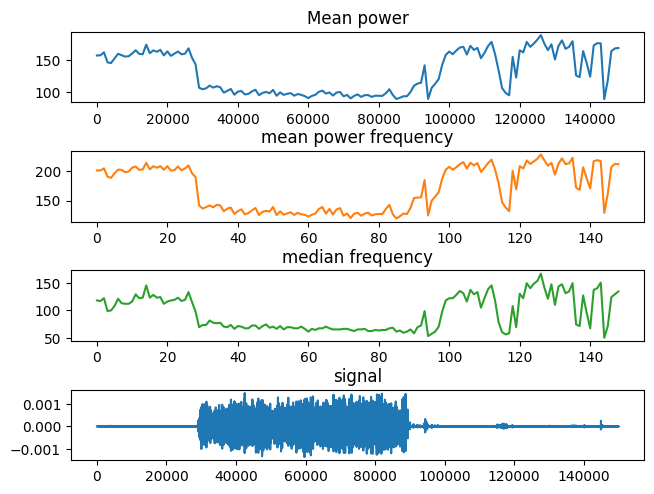

In [ ]:
fig, axs = plt.subplots(4,1)

axs[0].plot(np.array(range(ft.shape[0]))*1000, ft[:,0])
axs[0].set_title('Mean power')
axs[1].plot(ft[:,1], 'tab:orange')
axs[1].set_title('mean power frequency')
axs[2].plot(ft[:,2], 'tab:green')
axs[2].set_title('median frequency')

axs[3].plot(signal, label='Original Signal')
axs[3].set_title('signal')

#fig.subplots_adjust(bottom= 0.1,wspace=0.4 )
fig.tight_layout(pad=0.2)
fig.show()

In [ ]:
filtered

array([-1.11004138e-15, -1.29684683e-15, -1.48060274e-15, ...,
       -3.47867957e-06, -1.10723781e-06, -1.15456533e-06])

In [ ]:
np.array(final7)

array([ 0.e+00,  0.e+00,  0.e+00, ..., -1.e-06,  2.e-06,  2.e-06])

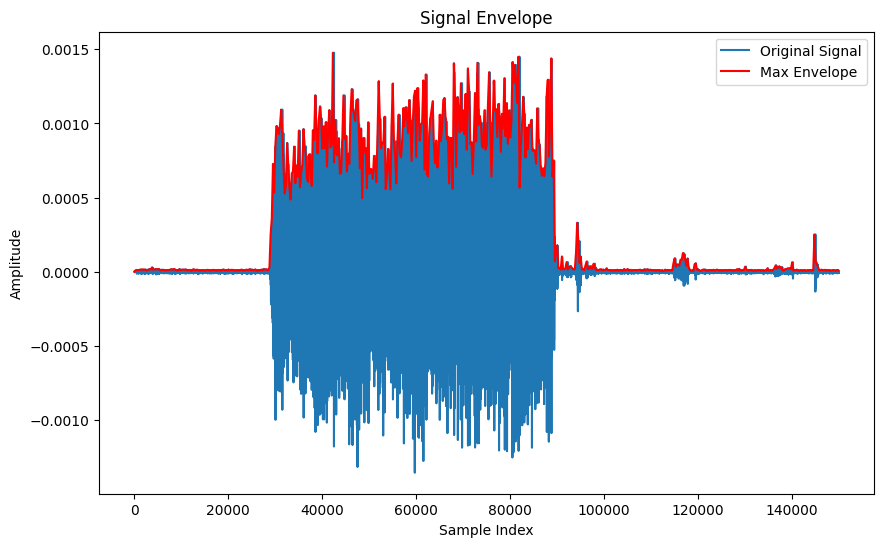

In [ ]:
import numpy as np
from matplotlib import pyplot as plt
 
def hl_envelopes_idx(s, dmax=250):
    """
    Input:
    - s: 1D array, data signal from which to extract high and low envelopes
    - dmin, dmax: int, optional, size of chunks (use if the input signal is large)
    - split: bool, optional, if True, split the signal along its mean
 
    Output:
    - lmin, lmax: high/low envelope indices of input signal s
    """
    data = []
    for i in range(0,len(s-dmax+1),dmax):
        data.append((i, np.max(s[i:i+dmax])))

 
    return np.array(data)
 
# Example usage:
signal =filtered# np.random.randn(1000)  # Replace with your actual signal
da = hl_envelopes_idx(signal)
 
# Plot the signal and its envelope
plt.figure(figsize=(10, 6))
plt.plot(signal, label='Original Signal')

plt.plot(da[:,0], da[:,1], 'r', label='Max Envelope')
plt.legend()
plt.xlabel('Sample Index')
plt.ylabel('Amplitude')
plt.title('Signal Envelope')
plt.show()

In [2]:
mGClient = MongoClient(f'mongodb://10.250.4.35:27017') 

In [10]:
db = mGClient['experiments']
collection = db['Exp_2024-04-15T12_45_39_932Z_live']
cursor = collection.find()


In [15]:
data = cursor.next()

In [21]:
type(data['_id'])

bson.objectid.ObjectId

In [43]:
from bson.objectid import ObjectId 
import datetime
import bson
import bytes

In [61]:
dt = datetime.datetime.fromisoformat("2024-04-15T12:45:41.36Z")

In [62]:
dt

datetime.datetime(2024, 4, 15, 12, 45, 41, 360000, tzinfo=datetime.timezone.utc)

In [63]:
ObjectId.from_datetime(dt)

ObjectId('661d21750000000000000000')

In [58]:
ìjson = {"data": "ciao", "time": dt, "_id": ObjectId.from_datetime(dt), }

In [59]:
collection.insert_one(ìjson)

InsertOneResult(ObjectId('661e9e5a0000000000000000'), acknowledged=True)

In [65]:
# datetime.datetime.now().isoformat() con z alla fine
timeISO = datetime.datetime.now().isoformat() + 'Z'

In [66]:
timeISO

'2024-04-16T16:32:20.847306Z'

In [2]:
import numpy as np

In [3]:
a = np.array([1,2,3,4,5,6,7,8,9,10])
b = a[-12:]

In [5]:
b[-8:]

array([ 3,  4,  5,  6,  7,  8,  9, 10])

In [8]:
colonnePassate = ["ciao", "cia","ci"]

In [9]:
for col in colonnePassate:
    try:
        final.pop(col)
    except:
        pass

In [11]:
final

{'ciao2': 'ciao2'}

## Threshold